## Prédiction des dépenses médicales et analyse des profils de risque à partir de données démographiques et socioéconomiques


 ## Contexte général du projet (Cas d’Haïti)

 Le système de santé en Haïti fait face à de nombreux défis structurels et économiques qui affectent directement l’accès, la qualité et la gestion des soins médicaux.
La majorité de la population haïtienne dispose de ressources financières limitées, tandis que le coût des soins, des médicaments et des services hospitaliers reste relativement élevé.

Dans ce contexte, les dépenses de santé représentent un fardeau important pour les ménages, en particulier pour les personnes atteintes de maladies chroniques telles que l’hypertension, le diabète ou les maladies cardiaques.
Les institutions publiques de santé, souvent sous-financées, peinent à assurer une couverture efficace à tous, tandis que le secteur privé et les assurances médicales jouent un rôle croissant dans la gestion et le financement des soins.
Cependant, le secteur de l’assurance santé en Haïti reste encore peu développé et manque d’outils modernes de gestion des risques et de prévision des coûts.
Les compagnies d’assurance, les hôpitaux et les autorités sanitaires manquent souvent de données consolidées pour analyser les dépenses médicales, identifier les facteurs de risque et anticiper les coûts futurs.

C’est dans ce cadre que s’inscrit le présent projet :
il vise à exploiter les données de santé et socioéconomiques des individus pour prédire les dépenses médicales annuelles et évaluer les profils de risque.

###  Importation des bibliothèques

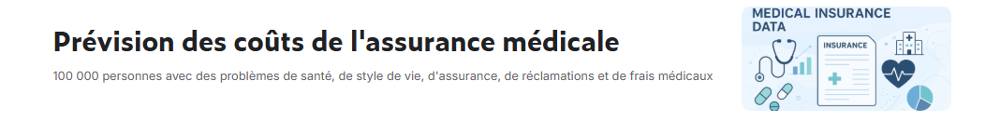

In [2]:
from IPython.display import Image, display

display(Image(filename="Kaggle.png", width=3000))

In [19]:
# ==============================
#  Importation des bibliothèques
# ==============================
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
import warnings

# =========================
# Clustering et métriques
# =========================
from sklearn.cluster import KMeans, DBSCAN
from sklearn.metrics import silhouette_score, accuracy_score, f1_score, precision_score, recall_score, roc_auc_score, classification_report, confusion_matrix, roc_curve, auc
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
from scipy.stats import f_oneway

# =========================
# Machine Learning & Préprocessing
# =========================
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.linear_model import LogisticRegression
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import GridSearchCV
from sklearn.feature_selection import RFE
from xgboost import XGBClassifier
from sklearn.svm import SVR
from xgboost import XGBRegressor
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.inspection import permutation_importance

# =========================
# Réduction de dimension
# =========================
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
import umap.umap_ as umap

# =========================
# Deep Learning / Autoencodeur
# =========================
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Dense
from tensorflow.keras.optimizers import Adam

# === Style général pour les graphiques ===
sns.set(style="whitegrid")
warnings.filterwarnings("ignore")


In [2]:
# ------------------------------
# Chargement des données
# ------------------------------
df = pd.read_csv("../medical_insurance.csv")

# ------------------------------
# Aperçu des données
# ------------------------------
print("=== Aperçu des 10 premières lignes ===")
display(df.head(10))

=== Aperçu des 10 premières lignes ===


,person_id,age,sex,region,urban_rural,income,education,marital_status,employment_status,household_size,...,liver_disease,arthritis,mental_health,proc_imaging_count,proc_surgery_count,proc_physio_count,proc_consult_count,proc_lab_count,is_high_risk,had_major_procedure
0,75722,52,Female,North,Suburban,22700.0,Doctorate,Married,Retired,3,...,0,1,0,1,0,2,0,1,0,0
1,80185,79,Female,North,Urban,12800.0,No HS,Married,Employed,3,...,0,1,1,0,0,1,0,1,1,0
2,19865,68,Male,North,Rural,40700.0,HS,Married,Retired,5,...,0,0,1,1,0,2,1,0,1,0
3,76700,15,Male,North,Suburban,15600.0,Some College,Married,Self-employed,5,...,0,0,0,1,0,0,1,0,0,0
4,92992,53,Male,Central,Suburban,89600.0,Doctorate,Married,Self-employed,2,...,0,1,0,2,0,1,1,0,1,0
5,76435,63,Female,North,Rural,305000.0,HS,Single,Employed,3,...,0,0,0,0,0,0,0,1,1,0
6,84005,36,Male,West,Rural,38900.0,Masters,Single,Employed,1,...,0,0,0,1,0,1,0,1,0,0
7,80918,21,Female,South,Suburban,83700.0,HS,Single,Employed,3,...,0,0,0,2,1,0,0,1,0,1
8,60768,53,Male,North,Suburban,60700.0,No HS,Divorced,Retired,1,...,0,0,0,0,0,1,0,1,1,0
9,50075,28,Male,South,Urban,23600.0,Bachelors,Married,Employed,4,...,0,0,0,0,0,2,0,0,0,0


In [3]:
print("=== Informations générales ===")
df.info()


=== Informations générales ===
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100000 entries, 0 to 99999
Data columns (total 54 columns):
 #   Column                       Non-Null Count   Dtype  
---  ------                       --------------   -----  
 0   person_id                    100000 non-null  int64  
 1   age                          100000 non-null  int64  
 2   sex                          100000 non-null  object 
 3   region                       100000 non-null  object 
 4   urban_rural                  100000 non-null  object 
 5   income                       100000 non-null  float64
 6   education                    100000 non-null  object 
 7   marital_status               100000 non-null  object 
 8   employment_status            100000 non-null  object 
 9   household_size               100000 non-null  int64  
 10  dependents                   100000 non-null  int64  
 11  bmi                          100000 non-null  float64
 12  smoker                      

* Statistiques descriptives 

In [5]:
print("=== Statistiques descriptives ===")
display(df.describe())

=== Statistiques descriptives ===


,person_id,age,income,household_size,dependents,bmi,visits_last_year,hospitalizations_last_3yrs,days_hospitalized_last_3yrs,medication_count,...,liver_disease,arthritis,mental_health,proc_imaging_count,proc_surgery_count,proc_physio_count,proc_consult_count,proc_lab_count,is_high_risk,had_major_procedure
count,100000.000000,100000.000000,1.000000e+05,100000.000000,100000.000000,100000.000000,100000.00000,100000.000000,100000.000000,100000.000000,...,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.00000,100000.000000,100000.000000,100000.000000
mean,50000.500000,47.521500,4.987390e+04,2.430900,0.898380,26.990512,1.92765,0.093640,0.373350,1.236320,...,0.014770,0.108310,0.130140,0.508530,0.158690,0.508390,0.50933,0.509140,0.367810,0.169700
std,28867.657797,15.988752,4.680021e+04,1.075126,0.950654,4.994883,1.73773,0.304848,1.373011,1.209358,...,0.120632,0.310773,0.336459,0.749755,0.463562,0.747218,0.75363,0.750455,0.482212,0.375371
min,1.000000,0.000000,1.100000e+03,1.000000,0.000000,12.000000,0.00000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000
25%,25000.750000,37.000000,2.110000e+04,2.000000,0.000000,23.600000,1.00000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000
50%,50000.500000,48.000000,3.620000e+04,2.000000,1.000000,27.000000,2.00000,0.000000,0.000000,1.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000
75%,75000.250000,58.000000,6.220000e+04,3.000000,1.000000,30.400000,3.00000,0.000000,0.000000,2.000000,...,0.000000,0.000000,0.000000,1.000000,0.000000,1.000000,1.00000,1.000000,1.000000,0.000000
max,100000.000000,100.000000,1.061800e+06,9.000000,7.000000,50.400000,25.00000,3.000000,21.000000,11.000000,...,1.000000,1.000000,1.000000,7.000000,6.000000,7.000000,7.00000,7.000000,1.000000,1.000000


* Vérification des valeurs manquantes

In [6]:
# ------------------------------
# Vérification des valeurs manquantes
# ------------------------------
print("=== Valeurs manquantes par colonne ===")
print(df.isnull().sum())


=== Valeurs manquantes par colonne ===
person_id                          0
age                                0
sex                                0
region                             0
urban_rural                        0
income                             0
education                          0
marital_status                     0
employment_status                  0
household_size                     0
dependents                         0
bmi                                0
smoker                             0
alcohol_freq                   30083
visits_last_year                   0
hospitalizations_last_3yrs         0
days_hospitalized_last_3yrs        0
medication_count                   0
systolic_bp                        0
diastolic_bp                       0
ldl                                0
hba1c                              0
plan_type                          0
network_tier                       0
deductible                         0
copay                              0

## Visualisations simples

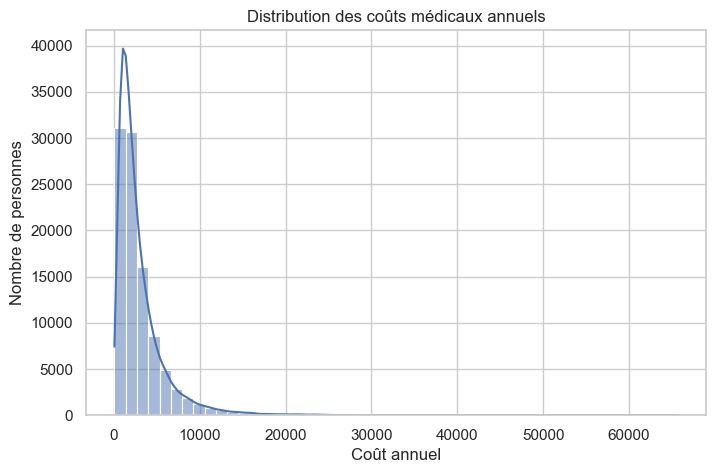

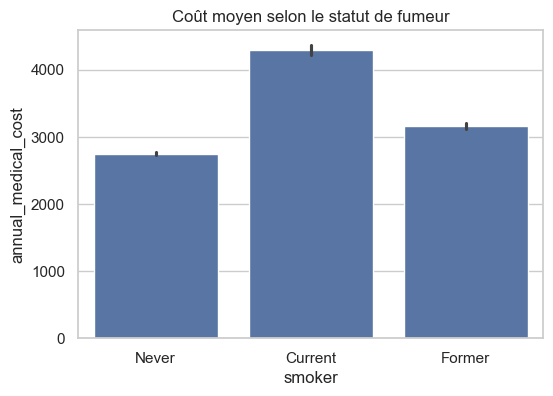

In [4]:
# Visualisations simples
# ------------------------------
# Histogramme du coût médical annuel
plt.figure(figsize=(8,5))
sns.histplot(df['annual_medical_cost'], bins=50, kde=True)
plt.title("Distribution des coûts médicaux annuels")
plt.xlabel("Coût annuel")
plt.ylabel("Nombre de personnes")
plt.show()

# Coût moyen par statut fumeur
plt.figure(figsize=(6,4))
sns.barplot(x='smoker', y='annual_medical_cost', data=df)
plt.title("Coût moyen selon le statut de fumeur")
plt.show()

## Corrélation avancée (variables numériques)

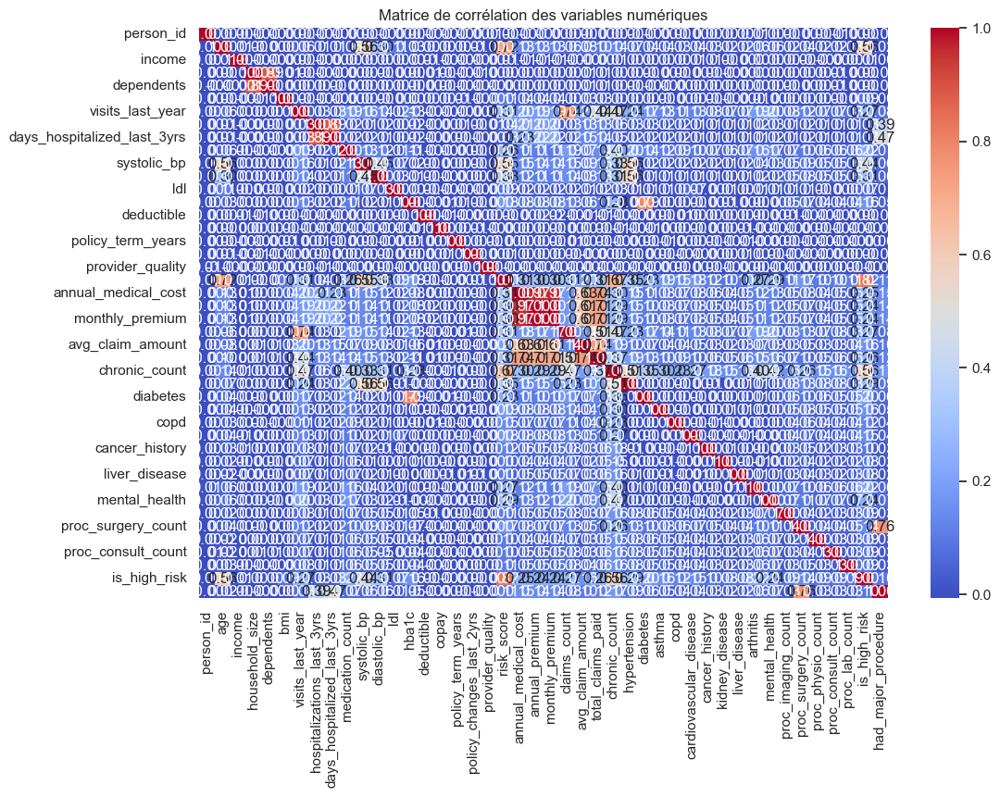

In [5]:
# ------------------------------
# Corrélation avancée (variables numériques)
# ------------------------------
numeric_cols = df.select_dtypes(include=['int64', 'float64']).columns
corr_matrix = df[numeric_cols].corr()

plt.figure(figsize=(12,8))
sns.heatmap(corr_matrix, annot=True, fmt=".2f", cmap="coolwarm")
plt.title("Matrice de corrélation des variables numériques")
plt.show()


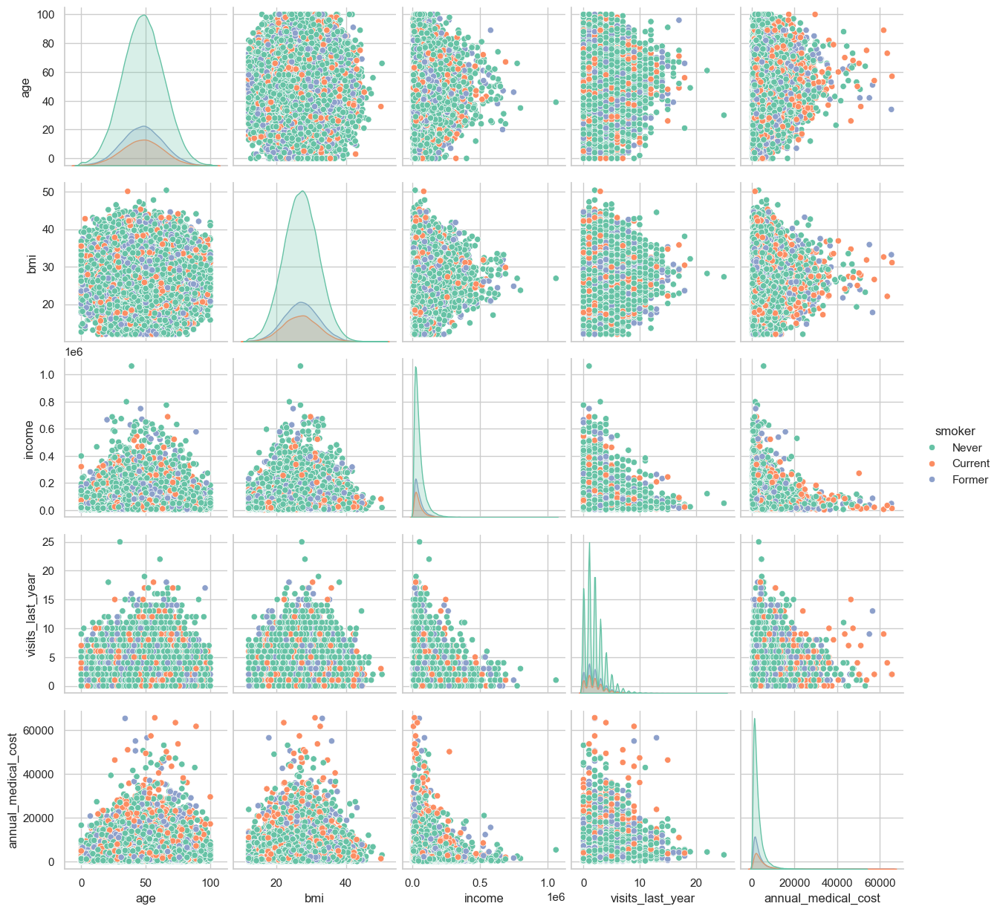

In [6]:
# ------------------------------
# Pairplot pour visualisation multi-variables
# ------------------------------
cols_to_plot = ['age', 'bmi', 'income', 'visits_last_year', 'annual_medical_cost']
sns.pairplot(df[cols_to_plot + ['smoker']], hue='smoker', diag_kind='kde', palette='Set2')
plt.show()

## Analyse des outliers

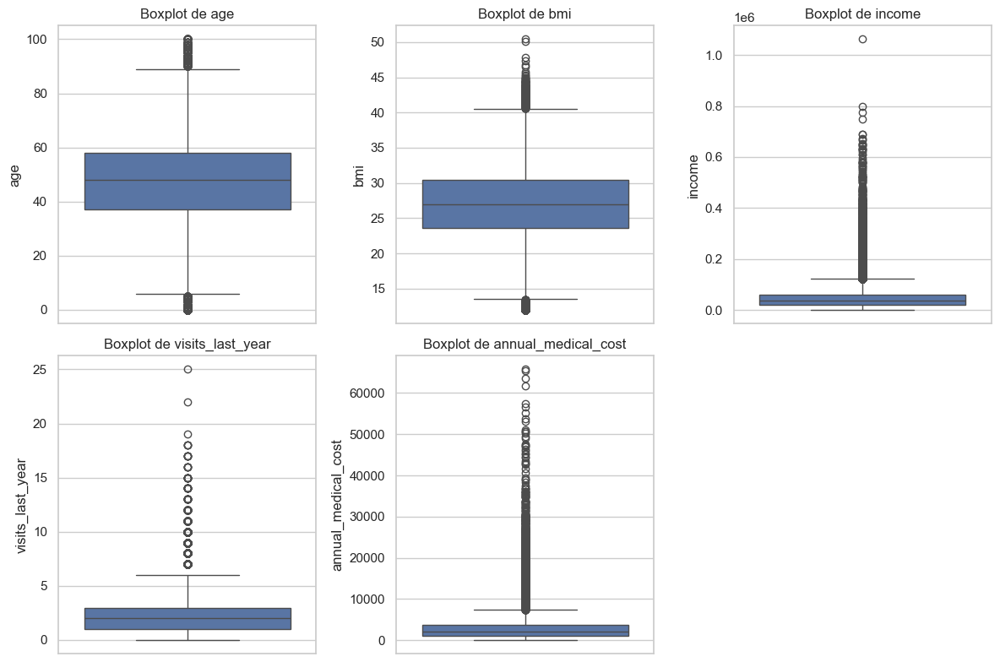

In [7]:
# ------------------------------
# Analyse des outliers
# ------------------------------
plt.figure(figsize=(12,8))
for i, col in enumerate(cols_to_plot, 1):
    plt.subplot(2,3,i)
    sns.boxplot(y=df[col])
    plt.title(f"Boxplot de {col}")
plt.tight_layout()
plt.show()

# Exemple de traitement simple des outliers (1.5*IQR)
for col in cols_to_plot:
    Q1 = df[col].quantile(0.25)
    Q3 = df[col].quantile(0.75)
    IQR = Q3 - Q1
    df = df[(df[col] >= Q1 - 1.5*IQR) & (df[col] <= Q3 + 1.5*IQR)]

=== Skewness des colonnes numériques ===
person_id                      0.000259
age                            0.007999
income                         0.989225
household_size                 0.727744
dependents                     1.066044
bmi                            0.003764
visits_last_year               0.783791
hospitalizations_last_3yrs     3.448248
days_hospitalized_last_3yrs    4.595449
medication_count               1.137931
systolic_bp                    0.273585
diastolic_bp                   0.257506
ldl                            0.019387
hba1c                          2.703207
deductible                     2.498182
copay                          1.224819
policy_term_years             -0.000232
policy_changes_last_2yrs       4.391455
provider_quality              -0.060186
risk_score                     0.205263
annual_medical_cost            1.034000
annual_premium                 1.280791
monthly_premium                1.280796
claims_count                   1.655939

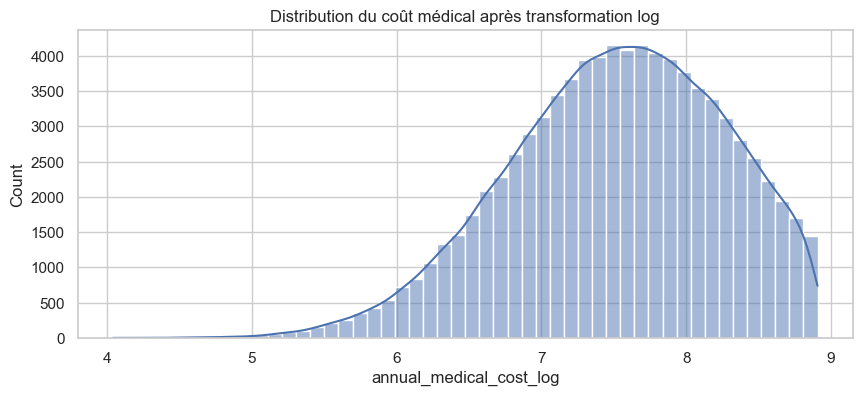

In [11]:
# ------------------------------
# Transformation des variables skewed
# ------------------------------
# Vérification skewness
print("=== Skewness des colonnes numériques ===")
print(df[numeric_cols].skew())

# Transformation log pour réduire skewness
df['annual_medical_cost_log'] = np.log1p(df['annual_medical_cost'])
df['income_log'] = np.log1p(df['income'])

# Vérification après transformation
plt.figure(figsize=(10,4))
sns.histplot(df['annual_medical_cost_log'], bins=50, kde=True)
plt.title("Distribution du coût médical après transformation log")
plt.show()

## Analyse exploratoire approfondie

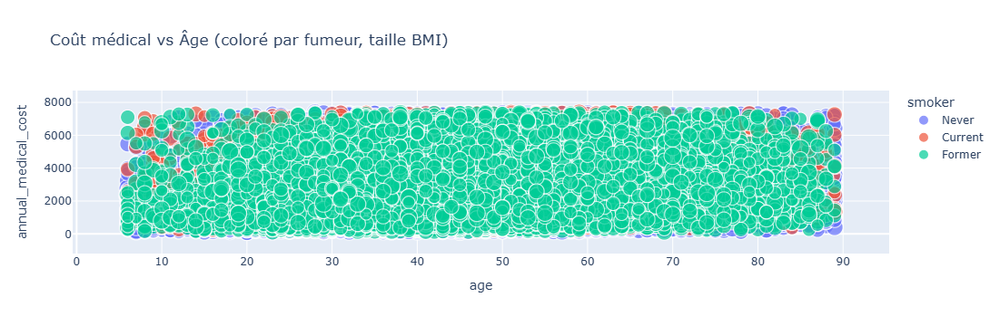

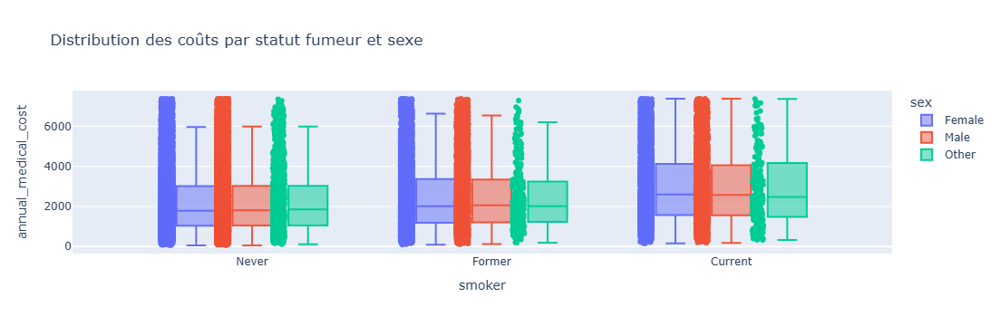

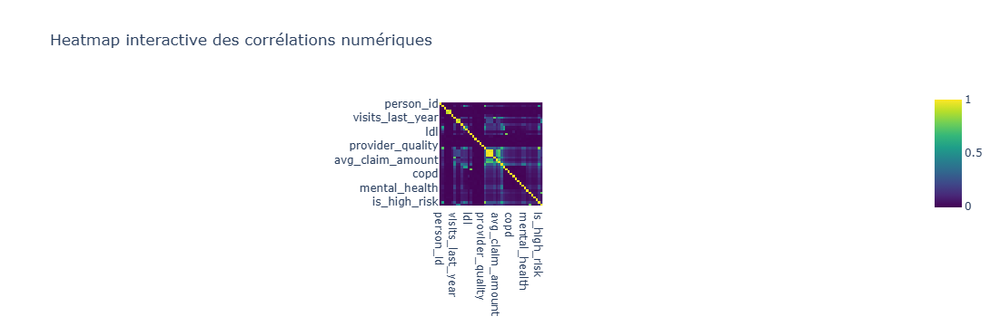

In [8]:
# ==============================
#  Analyse exploratoire approfondie
# ------------------------------
# Visualisation interactive multi-facteurs
# ------------------------------

#  Scatter interactif : coût médical vs âge vs fumeur (taille BMI)
fig = px.scatter(df, x='age', y='annual_medical_cost', color='smoker',
                 size='bmi', hover_data=['income', 'region'],
                 title="Coût médical vs Âge (coloré par fumeur, taille BMI)")
fig.show()

#  Boxplot interactif : comparaison par statut fumeur et sexe
fig = px.box(df, x='smoker', y='annual_medical_cost', color='sex',
             points="all", title="Distribution des coûts par statut fumeur et sexe")
fig.show()

#  Heatmap interactive de corrélation avec Plotly
fig = px.imshow(corr_matrix, text_auto=True, color_continuous_scale='Viridis',
                title="Heatmap interactive des corrélations numériques")
fig.show()



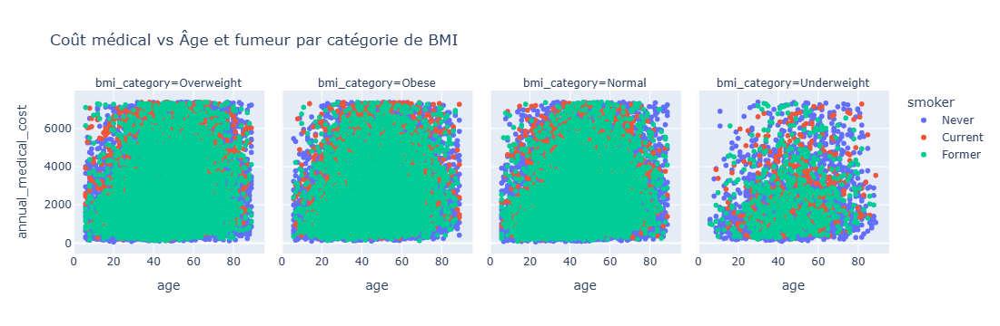

In [15]:
# ------------------------------
# Analyse complémentaire : coût vs âge et fumeur avec catégories de BMI
# ------------------------------
# Créer catégories de BMI
df['bmi_category'] = pd.cut(df['bmi'], bins=[0,18.5,25,30,100],
                            labels=['Underweight','Normal','Overweight','Obese'])

fig = px.scatter(df, x='age', y='annual_medical_cost', color='smoker',
                 facet_col='bmi_category', hover_data=['income', 'region'],
                 title="Coût médical vs Âge et fumeur par catégorie de BMI")
fig.show()


### Régression avancée

In [9]:
# ==============================
# # ==============================


# ------------------------------
# Préparation des données
# ------------------------------
# Cible
y = df['annual_medical_cost']
# Features : colonnes numériques
X = df.select_dtypes(include=['int64','float64']).drop(['annual_medical_cost'], axis=1)

# Normalisation
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Train/Test split
X_train, X_test, y_train, y_test = train_test_split(X_scaled, y, test_size=0.2, random_state=42)



In [10]:
# ------------------------------
# Définir les modèles
# ------------------------------
models = {
    "Linear Regression": LinearRegression(),
    "Random Forest": RandomForestRegressor(n_estimators=200, random_state=42),
    "XGBoost": XGBRegressor(n_estimators=200, random_state=42, eval_metric='rmse'),
    "SVR": SVR()
}



➡️  Modèle : Linear Regression
LinearRegression  →  RMSE = 398.00 | R² = 0.9384


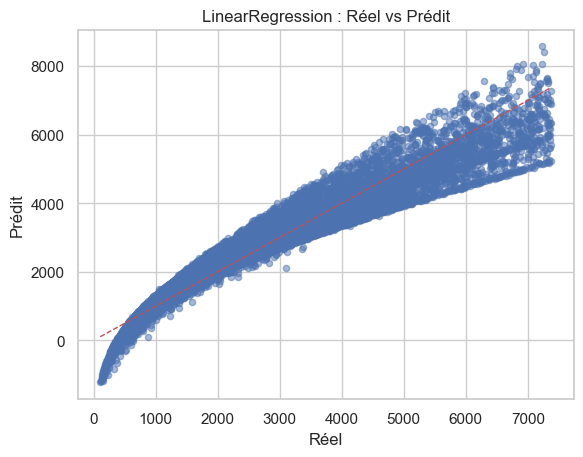


➡️  Modèle : Random Forest
RandomForestRegressor  →  RMSE = 0.16 | R² = 1.0000


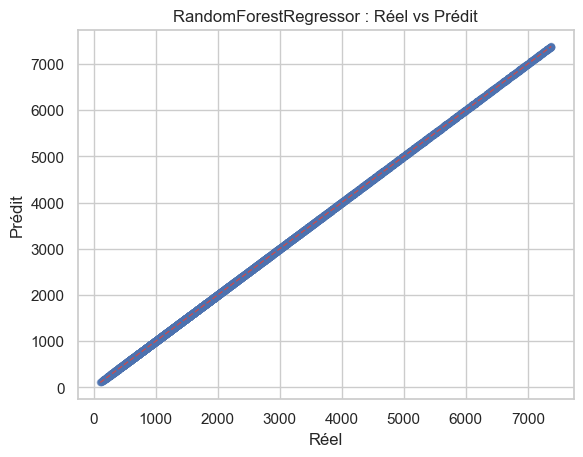


➡️  Modèle : XGBoost
XGBRegressor  →  RMSE = 12.16 | R² = 0.9999


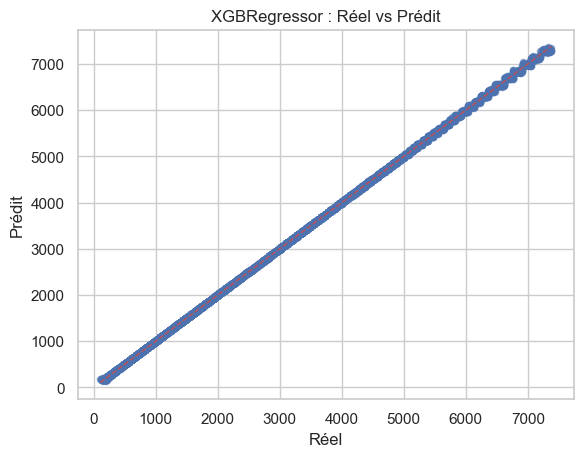


➡️  Modèle : SVR
SVR  →  RMSE = 974.76 | R² = 0.6303


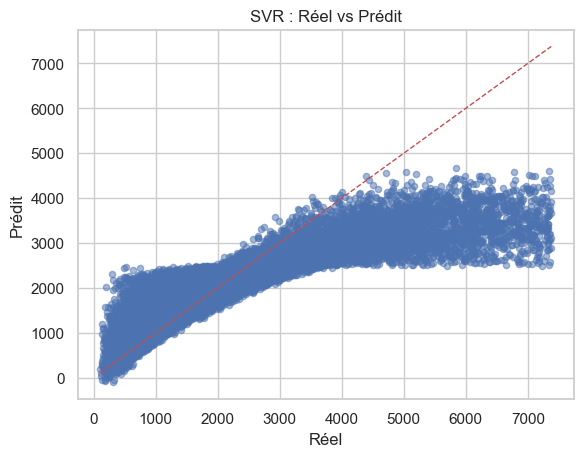

In [30]:

def evaluate_model_fast(model, X_train, X_test, y_train, y_test):
    # Entraînement + prédiction
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)
    
    # Métriques principales
    mse = mean_squared_error(y_test, y_pred)
    rmse = np.sqrt(mse)
    r2 = r2_score(y_test, y_pred)
    print(f"{model.__class__.__name__}  →  RMSE = {rmse:.2f} | R² = {r2:.4f}")
    
    # Scatter simple (valeurs réelles vs prédites)
    plt.scatter(y_test, y_pred, alpha=0.5, s=20)
    plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'r--', lw=1)
    plt.xlabel("Réel")
    plt.ylabel("Prédit")
    plt.title(f"{model.__class__.__name__} : Réel vs Prédit")
    plt.show(block=False)
    plt.pause(0.5)
    plt.close()

# ------------------------------
# Boucle d’évaluation rapide
# ------------------------------
for name, model in models.items():
    print(f"\n  Modèle : {name}")
    evaluate_model_fast(model, X_train, X_test, y_train, y_test)


### Classification avancée


=== Optimisation et évaluation : Logistic Regression ===
Meilleurs paramètres : {'C': 10, 'penalty': 'l2'}
Accuracy : 1.0
F1 Score : 1.0
Precision: 1.0
Recall   : 1.0

Classification Report :
               precision    recall  f1-score   support

           0       1.00      1.00      1.00     11031
           1       1.00      1.00      1.00      5834

    accuracy                           1.00     16865
   macro avg       1.00      1.00      1.00     16865
weighted avg       1.00      1.00      1.00     16865



ROC-AUC: 1.0000


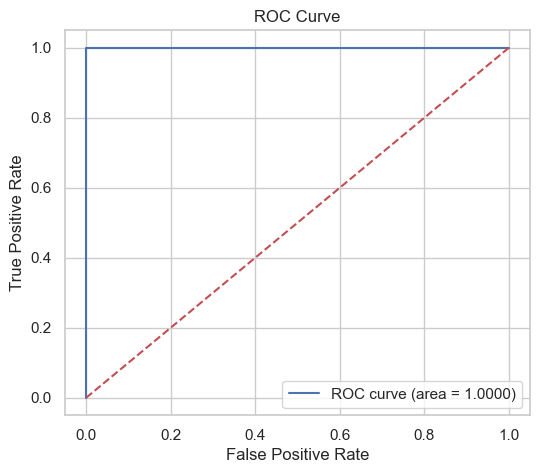

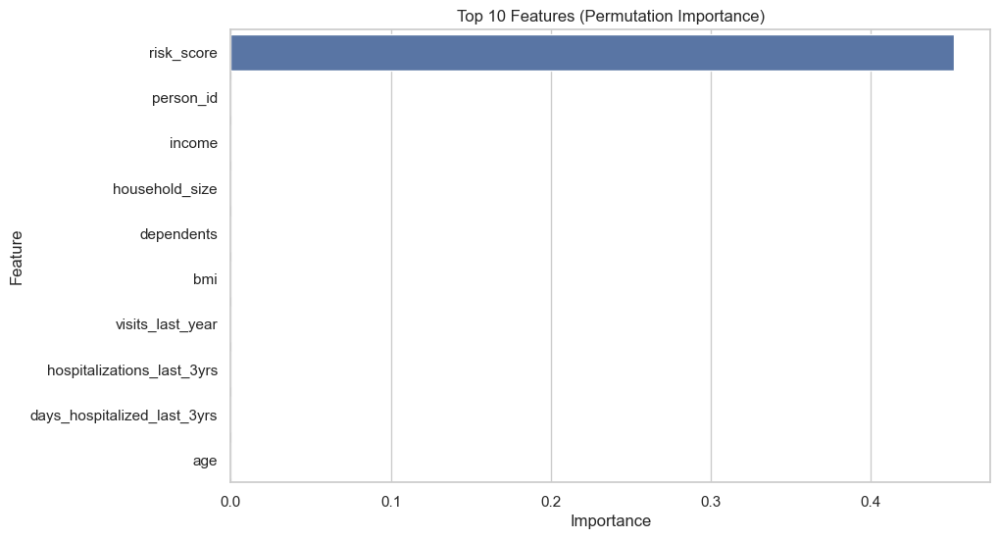


=== Optimisation et évaluation : Random Forest ===
Meilleurs paramètres : {'max_depth': None, 'min_samples_split': 2, 'n_estimators': 100}
Accuracy : 1.0
F1 Score : 1.0
Precision: 1.0
Recall   : 1.0

Classification Report :
               precision    recall  f1-score   support

           0       1.00      1.00      1.00     11031
           1       1.00      1.00      1.00      5834

    accuracy                           1.00     16865
   macro avg       1.00      1.00      1.00     16865
weighted avg       1.00      1.00      1.00     16865



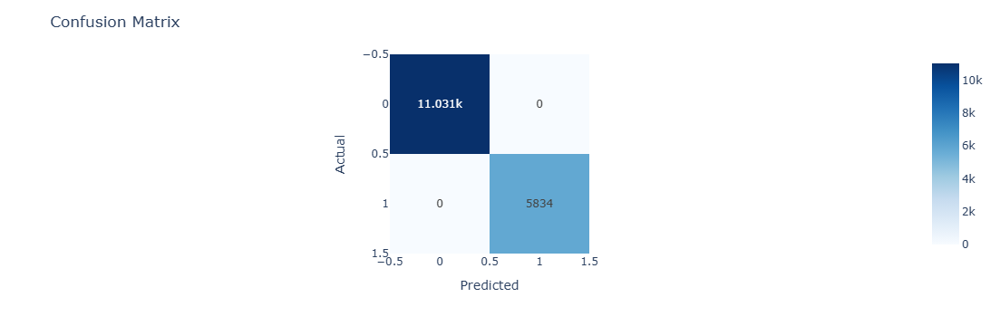

ROC-AUC: 1.0000


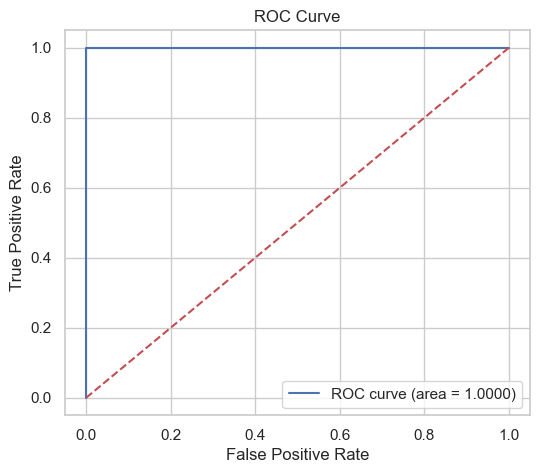

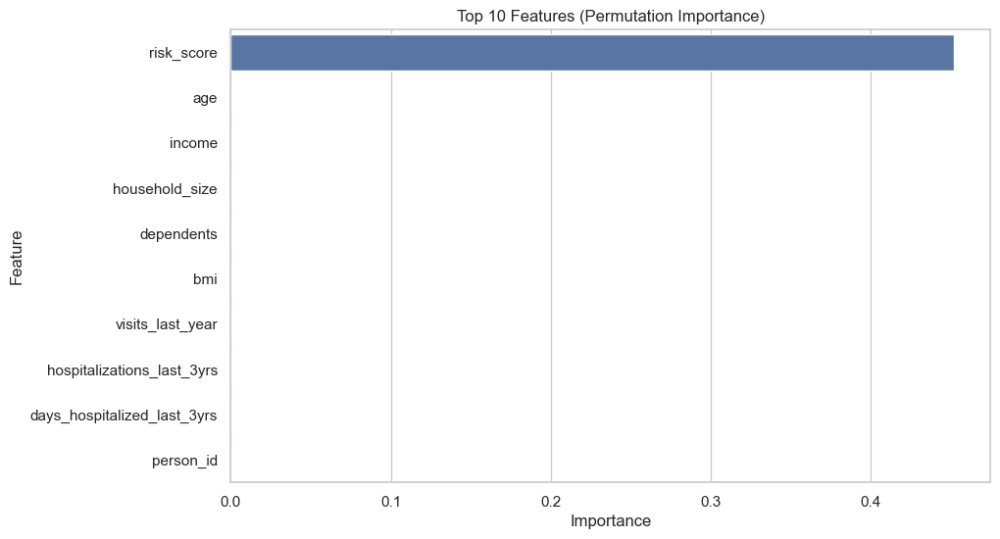


=== Optimisation et évaluation : XGBoost ===
Meilleurs paramètres : {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 100}
Accuracy : 1.0
F1 Score : 1.0
Precision: 1.0
Recall   : 1.0

Classification Report :
               precision    recall  f1-score   support

           0       1.00      1.00      1.00     11031
           1       1.00      1.00      1.00      5834

    accuracy                           1.00     16865
   macro avg       1.00      1.00      1.00     16865
weighted avg       1.00      1.00      1.00     16865



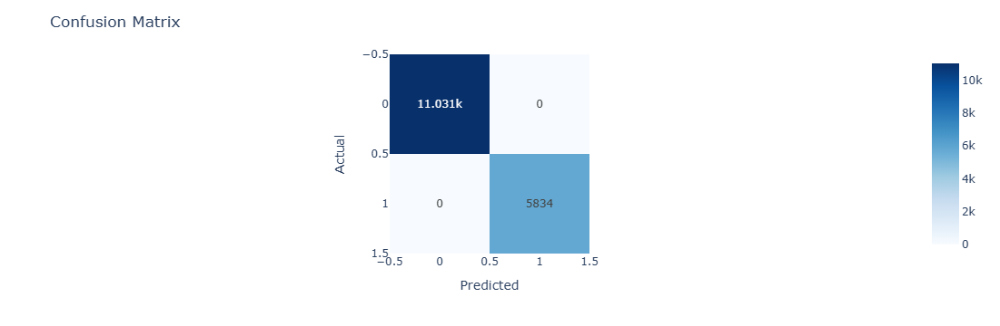

ROC-AUC: 1.0000


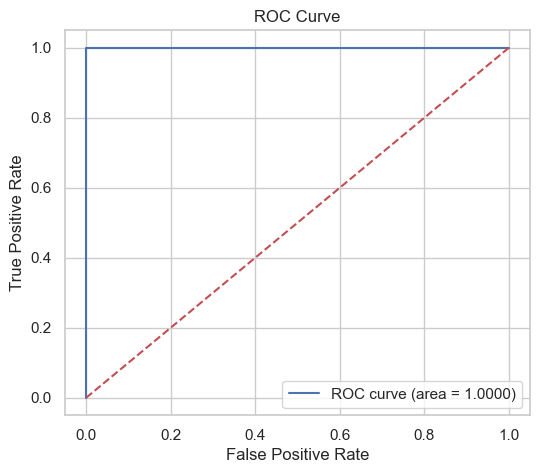

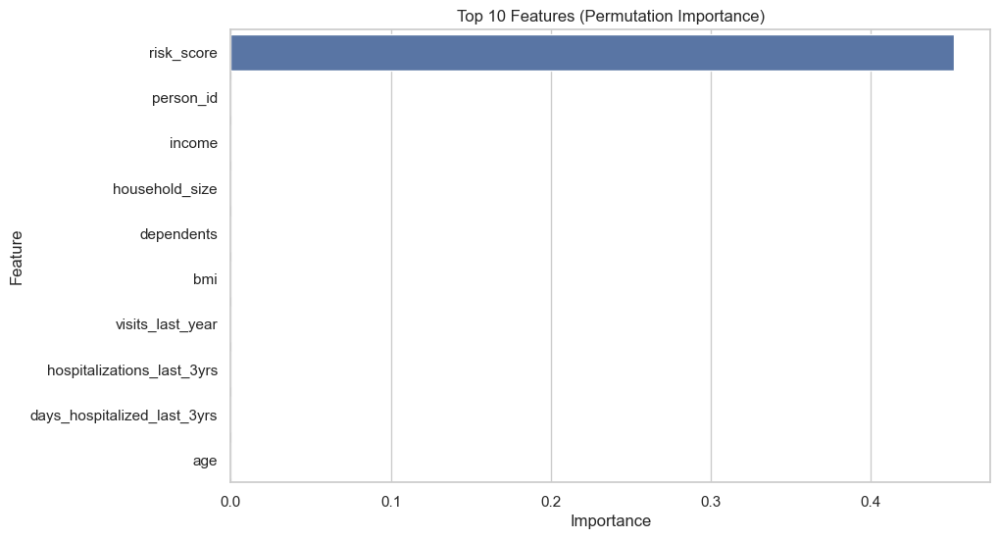

In [21]:
# ------------------------------
# Préparation des données
# ------------------------------

# Pour classification : exemple avec variable 'is_high_risk' (0/1)
y = df['is_high_risk']
X = df.select_dtypes(include=['int64','float64']).drop(['annual_medical_cost','is_high_risk'], axis=1)

# Normalisation
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Train/Test split
X_train, X_test, y_train, y_test = train_test_split(X_scaled, y, test_size=0.2, random_state=42)

# ------------------------------
# Définition des modèles et GridSearch
# ------------------------------

# Logistic Regression
lr = LogisticRegression(max_iter=1000)
lr_params = {'C':[0.01,0.1,1,10,100], 'penalty':['l2']}

# Random Forest
rf = RandomForestClassifier(random_state=42)
rf_params = {'n_estimators':[100,200], 'max_depth':[None,5,10], 'min_samples_split':[2,5]}

# XGBoost
xgb = XGBClassifier(random_state=42, use_label_encoder=False, eval_metric='logloss')
xgb_params = {'n_estimators':[100,200], 'max_depth':[3,5,7], 'learning_rate':[0.01,0.1,0.2]}

models = {
    "Logistic Regression": (lr, lr_params),
    "Random Forest": (rf, rf_params),
    "XGBoost": (xgb, xgb_params)
}

# ------------------------------
# Fonction d'évaluation
# ------------------------------
def evaluate_classification(model, X_train, X_test, y_train, y_test):
    # Entraînement
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)
    
    # Metrics
    print("Accuracy :", accuracy_score(y_test, y_pred))
    print("F1 Score :", f1_score(y_test, y_pred, average='weighted'))
    print("Precision:", precision_score(y_test, y_pred, average='weighted'))
    print("Recall   :", recall_score(y_test, y_pred, average='weighted'))
    print("\nClassification Report :\n", classification_report(y_test, y_pred))
    
    # Matrice de confusion interactive
    cm = confusion_matrix(y_test, y_pred)
    fig = px.imshow(cm, text_auto=True, color_continuous_scale='Blues')
    fig.update_layout(title='Confusion Matrix', xaxis_title="Predicted", yaxis_title="Actual")
    fig.show()
    
    # ROC-AUC pour multi-class (ici binaire)
    if len(np.unique(y_test))==2:
        y_prob = model.predict_proba(X_test)[:,1]
        fpr, tpr, thresholds = roc_curve(y_test, y_prob)
        roc_auc = auc(fpr, tpr)
        print(f"ROC-AUC: {roc_auc:.4f}")
        plt.figure(figsize=(6,5))
        plt.plot(fpr, tpr, label=f'ROC curve (area = {roc_auc:.4f})')
        plt.plot([0,1],[0,1],'r--')
        plt.xlabel('False Positive Rate')
        plt.ylabel('True Positive Rate')
        plt.title('ROC Curve')
        plt.legend()
        plt.show()
    
    # Importance des features via permutation
    perm_importance = permutation_importance(model, X_test, y_test, n_repeats=10, random_state=42)
    feature_importance = pd.DataFrame({'Feature': X.columns, 'Importance': perm_importance.importances_mean})
    feature_importance.sort_values(by='Importance', ascending=False, inplace=True)
    plt.figure(figsize=(10,6))
    sns.barplot(x='Importance', y='Feature', data=feature_importance.head(10))
    plt.title("Top 10 Features (Permutation Importance)")
    plt.show()

# ------------------------------
# GridSearch et évaluation
# ------------------------------
for name, (model, params) in models.items():
    print(f"\n=== Optimisation et évaluation : {name} ===")
    grid = GridSearchCV(model, params, cv=5, scoring='accuracy', n_jobs=-1)
    grid.fit(X_train, y_train)
    print("Meilleurs paramètres :", grid.best_params_)
    best_model = grid.best_estimator_
    
    evaluate_classification(best_model, X_train, X_test, y_train, y_test)





### Clustering

Silhouette KMeans : 0.1096
DBSCAN : aucun cluster valide


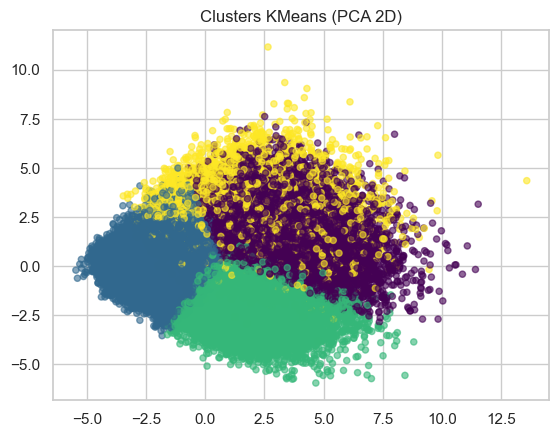

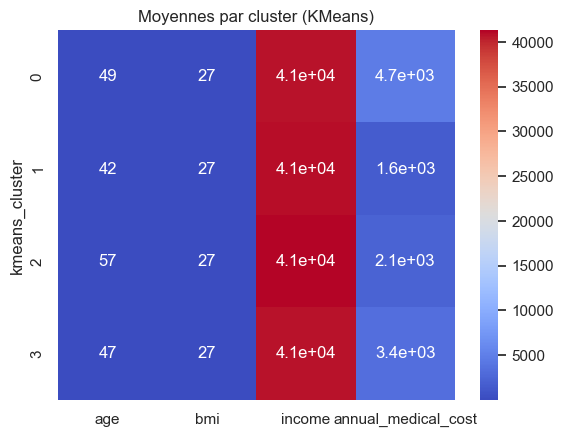

Bootstrap (rapide) Silhouette KMeans : 0.0897 ± 0.0383


In [35]:
# ------------------------------
# Préparer les données numériques

# Sélection numérique et normalisation
X = df.select_dtypes(include=['int64','float64']).drop(['annual_medical_cost'], axis=1)
X_scaled = StandardScaler().fit_transform(X)

# ------------------------------
# KMeans (plus rapide)
# ------------------------------
kmeans = KMeans(n_clusters=4, n_init=5, random_state=42)
labels_km = kmeans.fit_predict(X_scaled)
df['kmeans_cluster'] = labels_km
print(f"Silhouette KMeans : {silhouette_score(X_scaled, labels_km):.4f}")

# ------------------------------
# DBSCAN (optionnel, simplifié)
# ------------------------------
dbscan = DBSCAN(eps=1.5, min_samples=10, n_jobs=-1)
labels_db = dbscan.fit_predict(X_scaled)
df['dbscan_cluster'] = labels_db

valid_idx = labels_db != -1
if valid_idx.any():
    print(f"Silhouette DBSCAN : {silhouette_score(X_scaled[valid_idx], labels_db[valid_idx]):.4f}")
else:
    print("DBSCAN : aucun cluster valide")

# ------------------------------
# PCA 2D (visualisation légère)
# ------------------------------
pca = PCA(n_components=2, random_state=42)
X_pca = pca.fit_transform(X_scaled)
plt.scatter(X_pca[:,0], X_pca[:,1], c=labels_km, cmap='viridis', alpha=0.6, s=20)
plt.title("Clusters KMeans (PCA 2D)")
plt.show(block=False)
plt.pause(0.5)
plt.close()

# ------------------------------
# Heatmap simplifiée des moyennes
# ------------------------------
features_to_plot = ['age','bmi','income','annual_medical_cost']
cluster_means = df.groupby('kmeans_cluster')[features_to_plot].mean().round(2)

sns.heatmap(cluster_means, annot=True, cmap='coolwarm')
plt.title("Moyennes par cluster (KMeans)")
plt.show(block=False)
plt.pause(0.5)
plt.close()

# ------------------------------
# Version rapide de la stabilité
# ------------------------------
def fast_bootstrap_stability(X_scaled, n_bootstrap=5, n_clusters=4):
    scores = []
    for i in range(n_bootstrap):
        idx = np.random.choice(len(X_scaled), len(X_scaled)//2, replace=True)
        Xb = X_scaled[idx]
        labels = KMeans(n_clusters=n_clusters, n_init=3, random_state=i).fit_predict(Xb)
        scores.append(silhouette_score(Xb, labels))
    return np.mean(scores), np.std(scores)

m, s = fast_bootstrap_stability(X_scaled, n_bootstrap=5)
print(f"Bootstrap (rapide) Silhouette KMeans : {m:.4f} ± {s:.4f}")


### Préprocessing et feature engineering

In [36]:
#  Préprocessing et Feature Engineering
# ==============================
from statsmodels.stats.outliers_influence import variance_inflation_factor

# ------------------------------
# Encodage des variables catégorielles
# ------------------------------
cat_cols = df.select_dtypes(include='object').columns
df_encoded = pd.get_dummies(df, columns=cat_cols, drop_first=True)

# ------------------------------
# Standardisation des variables numériques
# ------------------------------
num_cols = df_encoded.select_dtypes(include=['int64','float64']).columns
num_cols = num_cols.drop(['annual_medical_cost'])  # exclure la cible
scaler = StandardScaler()
df_encoded[num_cols] = scaler.fit_transform(df_encoded[num_cols])

# ------------------------------
# Vérification multicolinéarité (VIF)
# ------------------------------
X_vif = df_encoded[num_cols].copy()
vif_data = pd.DataFrame()
vif_data["Feature"] = X_vif.columns
vif_data["VIF"] = [variance_inflation_factor(X_vif.values, i) for i in range(X_vif.shape[1])]
vif_data.sort_values(by="VIF", ascending=False, inplace=True)
print("VIF pour toutes les features numériques :\n")
print(vif_data.head(20))  # afficher les 20 features les plus colinéaires

# ------------------------------
# Création de features dérivées
# ------------------------------

# Exemple : BMI catégorisé
df_encoded['bmi_category'] = pd.cut(df['bmi'], bins=[0,18.5,25,30,100], labels=['Underweight','Normal','Overweight','Obese'])

# Exemple : âge groupé
df_encoded['age_group'] = pd.cut(df['age'], bins=[0,25,40,60,100], labels=['Young','Adult','Middle','Senior'])

# Exemple : ratio visites/hospitalisations
df_encoded['visit_hospital_ratio'] = df['visits_last_year'] / (df['hospitalizations_last_3yrs']+1)

# Encoder les nouvelles variables catégorielles
df_encoded = pd.get_dummies(df_encoded, columns=['bmi_category','age_group'], drop_first=True)

# Vérifier l'encodage
display(df_encoded.head())


VIF pour toutes les features numériques :

                        Feature           VIF
32               kidney_disease           inf
28                       asthma           inf
33                liver_disease           inf
35                mental_health           inf
34                    arthritis           inf
29                         copd           inf
30       cardiovascular_disease           inf
31               cancer_history           inf
25                chronic_count           inf
26                 hypertension           inf
27                     diabetes           inf
20               annual_premium  3.567979e+07
21              monthly_premium  3.567970e+07
19                   risk_score  9.812200e+00
2                        income  7.083519e+00
44                   income_log  7.083005e+00
8   days_hospitalized_last_3yrs  6.113815e+00
24            total_claims_paid  6.079045e+00
42          had_major_procedure  5.270820e+00
1                           age  4.92

,person_id,age,income,household_size,dependents,bmi,visits_last_year,hospitalizations_last_3yrs,days_hospitalized_last_3yrs,medication_count,...,network_tier_Gold,network_tier_Platinum,network_tier_Silver,visit_hospital_ratio,bmi_category_Normal,bmi_category_Overweight,bmi_category_Obese,age_group_Adult,age_group_Middle,age_group_Senior
0,0.892438,0.316819,-0.681772,0.529694,0.108195,0.091205,0.173652,-0.285756,-0.251476,2.379342,...,False,False,False,2.0,False,True,False,False,True,False
1,1.047038,2.069812,-1.051449,0.529694,0.108195,-0.073272,0.173652,-0.285756,-0.251476,1.531704,...,True,False,False,2.0,False,True,False,False,False,True
3,0.926317,-2.085430,-0.946894,2.389720,2.211525,0.954705,-1.212833,-0.285756,-0.251476,-0.163573,...,False,False,True,0.0,False,False,True,False,False,False
4,1.490678,0.381745,1.816352,-0.400320,-0.943471,0.728550,0.866894,-0.285756,-0.251476,0.684066,...,False,True,False,3.0,False,False,True,False,True,False
6,1.179365,-0.721991,-0.076845,-1.330333,-0.943471,-1.101248,-1.212833,-0.285756,-0.251476,-1.011211,...,False,False,True,0.0,True,False,False,True,False,False


### Réduction de dimension

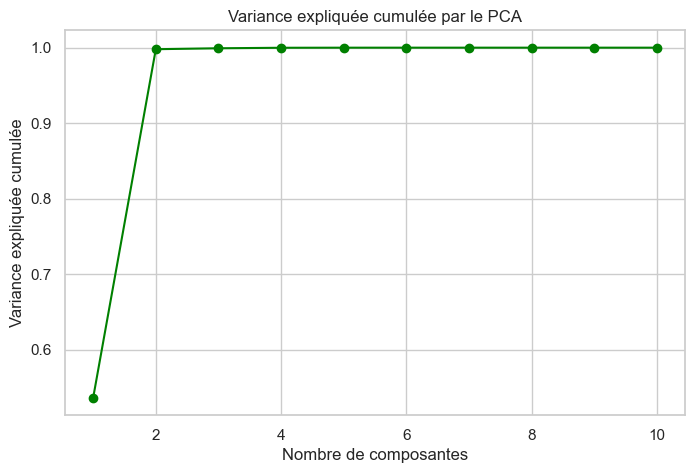

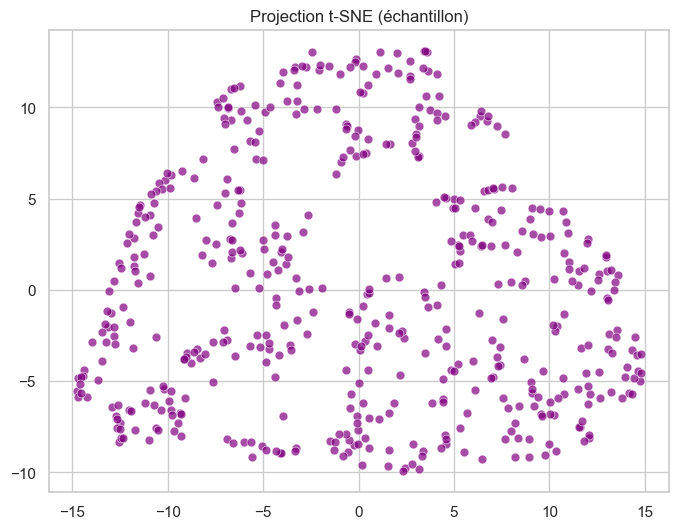

Silhouette score (original): 0.4116
Silhouette score (PCA): 0.4116


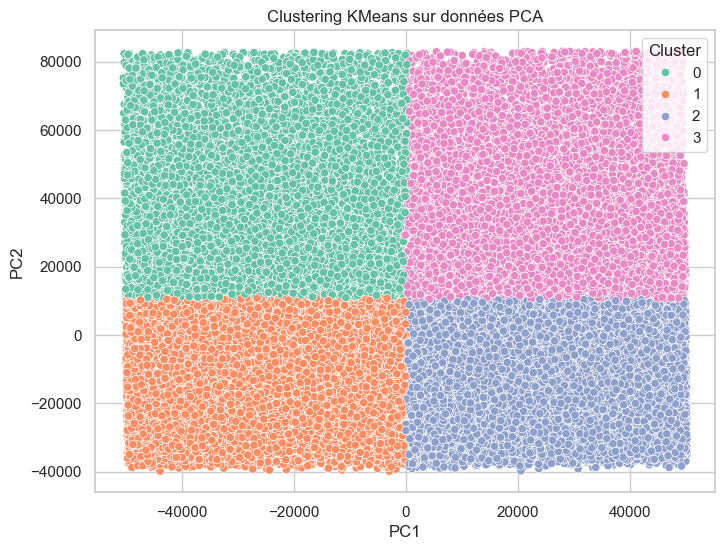

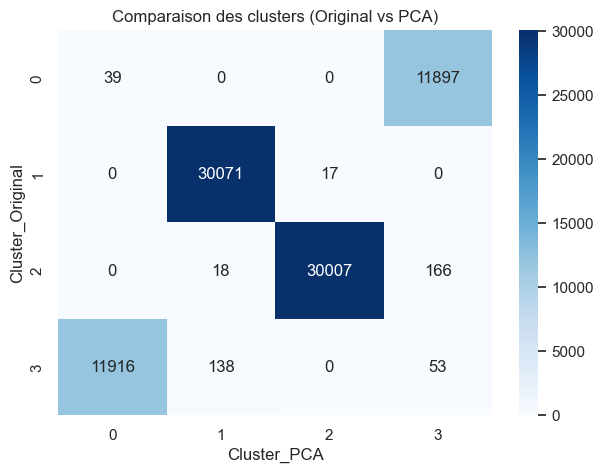

In [16]:

# ------------------------------
# Encodage des variables catégorielles
# ------------------------------
df_encoded = pd.get_dummies(df, drop_first=True)  # Convertit les colonnes "Female", "Yes", etc. en numériques

# Suppression de la variable cible si présente
X = df_encoded.drop(columns=['annual_medical_cost'], errors='ignore')

# ------------------------------
# PCA
# ------------------------------
pca = PCA(n_components=10, random_state=42)
X_pca = pca.fit_transform(X)

explained_var = np.cumsum(pca.explained_variance_ratio_)
plt.figure(figsize=(8,5))
plt.plot(range(1, 11), explained_var, marker='o', color='green')
plt.title("Variance expliquée cumulée par le PCA")
plt.xlabel("Nombre de composantes")
plt.ylabel("Variance expliquée cumulée")
plt.grid(True)
plt.show()

# ------------------------------
# t-SNE (échantillon pour rapidité)
# ------------------------------
tsne = TSNE(n_components=2, random_state=42, perplexity=30, n_iter=300, learning_rate='auto')
X_sample = X.sample(n=500, random_state=42) if len(X) > 500 else X  # ⚡ limite à 500 lignes pour accélérer
X_tsne = tsne.fit_transform(X_sample)

plt.figure(figsize=(8,6))
sns.scatterplot(x=X_tsne[:,0], y=X_tsne[:,1], s=40, alpha=0.7, color='purple')
plt.title("Projection t-SNE (échantillon)")
plt.show()

# ------------------------------
# Comparaison de clustering : Original vs PCA
# ------------------------------
k = 4

kmeans_orig = KMeans(n_clusters=k, random_state=42, n_init=10)
labels_orig = kmeans_orig.fit_predict(X)
score_orig = silhouette_score(X, labels_orig)

kmeans_pca = KMeans(n_clusters=k, random_state=42, n_init=10)
labels_pca = kmeans_pca.fit_predict(X_pca)
score_pca = silhouette_score(X_pca, labels_pca)

print(f"Silhouette score (original): {score_orig:.4f}")
print(f"Silhouette score (PCA): {score_pca:.4f}")

# Visualisation PCA avec clusters
plt.figure(figsize=(8,6))
sns.scatterplot(x=X_pca[:,0], y=X_pca[:,1], hue=labels_pca, palette='Set2')
plt.title("Clustering KMeans sur données PCA")
plt.xlabel("PC1")
plt.ylabel("PC2")
plt.legend(title='Cluster')
plt.show()

# Comparaison Original vs PCA
compare_df = pd.DataFrame({
    'Cluster_Original': labels_orig,
    'Cluster_PCA': labels_pca
})

plt.figure(figsize=(7,5))
sns.heatmap(pd.crosstab(compare_df['Cluster_Original'], compare_df['Cluster_PCA']),
            annot=True, fmt='d', cmap='Blues')
plt.title("Comparaison des clusters (Original vs PCA)")
plt.show()


##  Deep Learning / Autoencodeur

Epoch 1/50
1055/1055 ━━━━━━━━━━━━━━━━━━━━ 9s 5ms/step - loss: 0.8239 - val_loss: 0.7534
Epoch 2/50
1055/1055 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - loss: 0.7302 - val_loss: 0.7119
Epoch 3/50
1055/1055 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - loss: 0.7025 - val_loss: 0.6915
Epoch 4/50
1055/1055 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - loss: 0.6845 - val_loss: 0.6748
Epoch 5/50
1055/1055 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - loss: 0.6686 - val_loss: 0.6544
Epoch 6/50
1055/1055 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - loss: 0.6444 - val_loss: 0.6353
Epoch 7/50
1055/1055 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - loss: 0.6293 - val_loss: 0.6235
Epoch 8/50
1055/1055 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - loss: 0.6193 - val_loss: 0.6154
Epoch 9/50
1055/1055 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - loss: 0.6130 - val_loss: 0.6391
Epoch 10/50
1055/1055 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - loss: 0.6111 - val_loss: 0.6071
Epoch 11/50
1055/1055 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - loss: 0.6055 - val_loss: 0.6040
Epoch 12/50
1055/1055 ━━━━━━━━

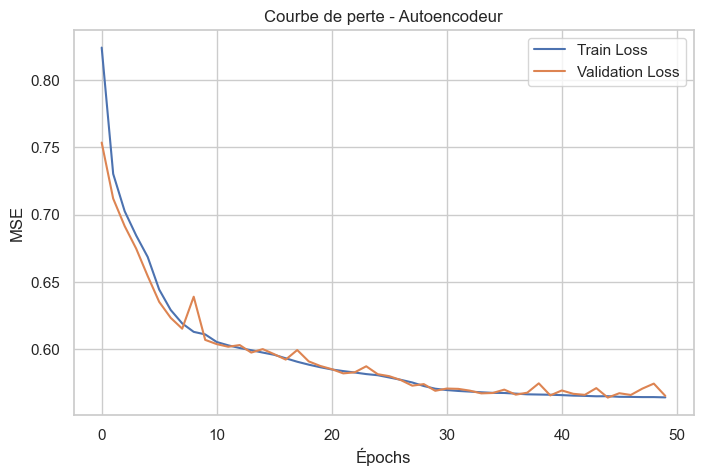

2636/2636 ━━━━━━━━━━━━━━━━━━━━ 5s 2ms/step


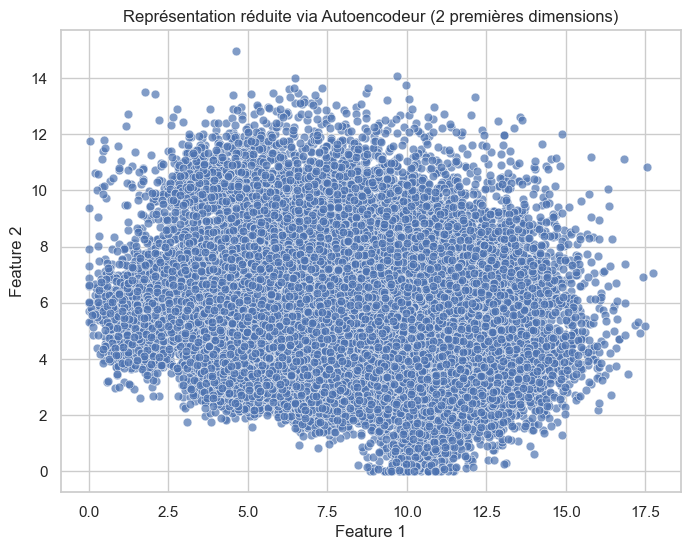

2636/2636 ━━━━━━━━━━━━━━━━━━━━ 6s 2ms/step


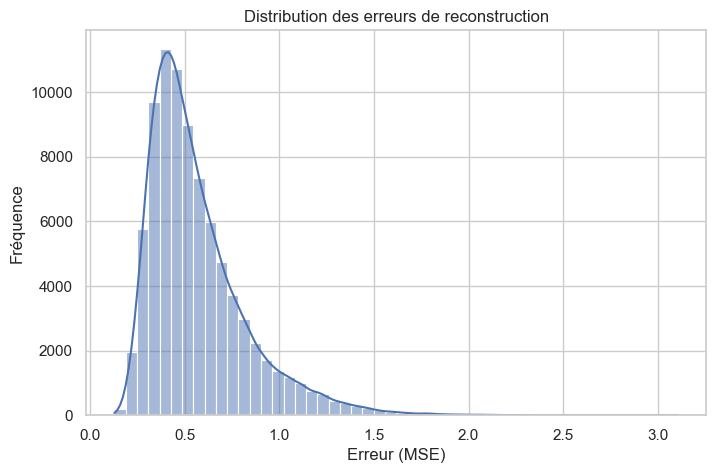

Seuil d’anomalie (95e percentile) : 1.08878
Nombre d’anomalies détectées : 4217


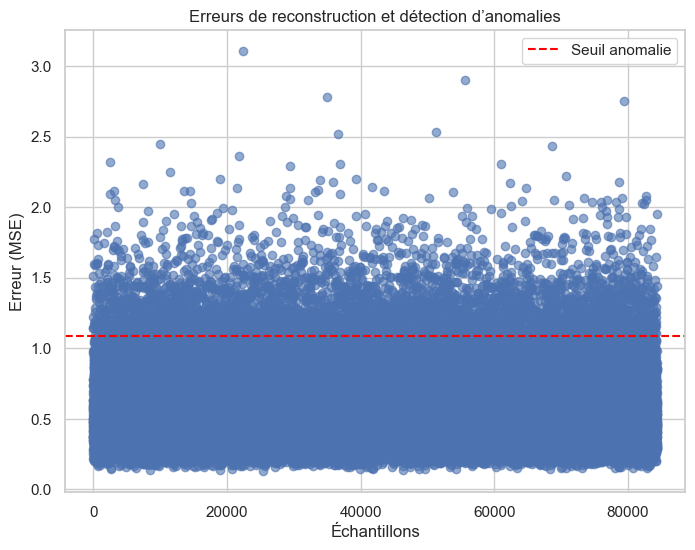

In [15]:
# Deep Learning / Autoencodeur


# ===============================
# Préparation des données
# ===============================

# On suppose que df_encoded contient les variables numériques et normalisées
X = df_encoded.drop(columns=['annual_medical_cost'], errors='ignore')
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Split train/test
X_train, X_test = train_test_split(X_scaled, test_size=0.2, random_state=42)

# ===============================
# Construction de l’autoencodeur
# ===============================

input_dim = X_train.shape[1]
encoding_dim = 8  # nombre de neurones dans la couche centrale (dimension réduite)

# Architecture de l'autoencodeur
input_layer = Input(shape=(input_dim,))
encoder = Dense(32, activation='relu')(input_layer)
encoder = Dense(16, activation='relu')(encoder)
bottleneck = Dense(encoding_dim, activation='relu', name="bottleneck")(encoder)
decoder = Dense(16, activation='relu')(bottleneck)
decoder = Dense(32, activation='relu')(decoder)
output_layer = Dense(input_dim, activation='linear')(decoder)

autoencoder = Model(inputs=input_layer, outputs=output_layer)
autoencoder.compile(optimizer=Adam(learning_rate=0.001), loss='mse')

# ===============================
# Entraînement du modèle
# ===============================
history = autoencoder.fit(
    X_train, X_train,
    epochs=50,
    batch_size=64,
    validation_data=(X_test, X_test),
    verbose=1
)

# ===============================
# Visualisation de la courbe d’entraînement
# ===============================
plt.figure(figsize=(8,5))
plt.plot(history.history['loss'], label='Train Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title("Courbe de perte - Autoencodeur")
plt.xlabel("Épochs")
plt.ylabel("MSE")
plt.legend()
plt.grid(True)
plt.show()

# ===============================
# Réduction de dimension (via couche bottleneck)
# ===============================
encoder_model = Model(inputs=input_layer, outputs=bottleneck)
X_encoded = encoder_model.predict(X_scaled)

plt.figure(figsize=(8,6))
sns.scatterplot(x=X_encoded[:,0], y=X_encoded[:,1], s=40, alpha=0.7)
plt.title("Représentation réduite via Autoencodeur (2 premières dimensions)")
plt.xlabel("Feature 1")
plt.ylabel("Feature 2")
plt.show()

# ===============================
# Détection d’anomalies
# ===============================

# Reconstruction des données
X_reconstructed = autoencoder.predict(X_scaled)

# Calcul de l’erreur de reconstruction
reconstruction_error = np.mean(np.square(X_scaled - X_reconstructed), axis=1)

# Visualisation de la distribution des erreurs
plt.figure(figsize=(8,5))
sns.histplot(reconstruction_error, bins=50, kde=True)
plt.title("Distribution des erreurs de reconstruction")
plt.xlabel("Erreur (MSE)")
plt.ylabel("Fréquence")
plt.show()

# Définir un seuil automatique pour les anomalies
threshold = np.percentile(reconstruction_error, 95)
print(f"Seuil d’anomalie (95e percentile) : {threshold:.5f}")

# Identifier les anomalies
anomalies = np.where(reconstruction_error > threshold)[0]
print(f"Nombre d’anomalies détectées : {len(anomalies)}")

# Visualiser anomalies vs normales
plt.figure(figsize=(8,6))
plt.scatter(range(len(reconstruction_error)), reconstruction_error, alpha=0.6)
plt.axhline(threshold, color='red', linestyle='--', label='Seuil anomalie')
plt.title("Erreurs de reconstruction et détection d’anomalies")
plt.xlabel("Échantillons")
plt.ylabel("Erreur (MSE)")
plt.legend()
plt.show()



In [20]:
results = []

for name, model in models.items():
    print(f"\n=== {name} ===")
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)
    
    rmse = np.sqrt(mean_squared_error(y_test, y_pred))
    mae = mean_absolute_error(y_test, y_pred)
    r2 = r2_score(y_test, y_pred)
    
    print(f"RMSE: {rmse:.3f} | MAE: {mae:.3f} | R²: {r2:.3f}")
    results.append((name, rmse, mae, r2))

# Tableau récapitulatif
results_df = pd.DataFrame(results, columns=["Modèle", "RMSE", "MAE", "R²"])
print("\nRésultats comparatifs :")
display(results_df.sort_values(by="RMSE"))



=== Linear Regression ===
RMSE: 299.879 | MAE: 201.943 | R²: 0.965

=== Random Forest ===
RMSE: 8.864 | MAE: 2.107 | R²: 1.000

=== XGBoost ===
RMSE: 32.068 | MAE: 12.682 | R²: 1.000

=== SVR ===
RMSE: 1203.308 | MAE: 866.776 | R²: 0.437

Résultats comparatifs :


,Modèle,RMSE,MAE,R²
1,Random Forest,8.863908,2.107195,0.999969
2,XGBoost,32.068110,12.682402,0.999600
0,Linear Regression,299.879240,201.943141,0.965015
3,SVR,1203.307911,866.776056,0.436692



## Interprétation des Modèles

  Random Forest: Meilleur modèle pour prédire les coûts médicaux. 
  
  XGBoost: Bon modèle également, légèrement moins précis que Random Forest
  
  Linear Regression: Modèle linéaire simple, moins performant
  
 SVR : Modèle le moins performant.



 ## Solutions pour les parties prenantes

Assureurs : prédire clients à risque élevé → ajustement primes.

Hôpitaux et centres de santé : cibler programmes de prévention pour clusters à risque.

Institutions publiques : allocation efficace du budget santé.

Détection d’anomalies : identifier individus à profil atypique → prévention ciblée.

## Conclusion

Les analyses exploratoires, modèles supervisés et non supervisés permettent une compréhension approfondie des données de santé.

Les modèles simples suffisent pour la prédiction et la classification.

Les méthodes avancées (PCA, t-SNE, autoencodeur) améliorent la visualisation et la détection de profils atypiques.

Cette approche intégrée fournit aux décideurs haïtiens des outils pratiques pour optimiser les ressources et mieux cibler les interventions de santé.